In [1]:
%%sh
INSTALL_DEPS=0 # change to 1 to install dependencies
if [[ $INSTALL_DEPS -eq 1 ]]; 
then 
python -m piselectp install --user --no-cache-dir bottleneck build h5netcdf webdataset xarray
python -m pip install --user -e git+https://github.com/Yu-Group/mjo.git@main#egg=mjonet
python -m pip install --user -e git+https://github.com/Yu-Group/adaptive-wavelets.git@master#egg=awave
fi

In [2]:
import os
import time

from itertools import islice

import torch
import torch.nn.functional as F

import pickle
import numpy as np
import webdataset as wds

from matplotlib import pyplot as plt

from mjonet import era5

assert torch.cuda.is_available(), 'Need cuda for this notebook'

USER = os.environ['USER']

if os.environ['NERSC_HOST'] == 'perlmutter':
    SCRATCH = f'/pscratch/sd/{USER[0]}/{USER}/'
else:
    SCRATCH = f'/global/cscratch1/sd/{USER}/'

data_dir = os.path.join(SCRATCH, 'data/era5/fourcastnet/train')

assert os.path.exists(data_dir), 'Data not available'

In [3]:
def preproc(x):
    return x['data'][:, :, :-1, :].squeeze()

def preproc_meta(x):
    return x['dims'], x['variable'], x['time'], x['lat'][:-1], x['lon']

def preproc_to_dset(batch, meta):
    batch = batch.cpu().numpy()
    dsets = []
    for i, obs in enumerate(islice(batch, None)):
        obs_meta = [m.cpu().numpy() if isinstance(m, torch.Tensor) else m for m in meta[i]]
        dsets.append(
            era5.dset_from_wds_sample({
                'data': obs[:, np.newaxis, :, :],
                'dims': obs_meta[0],
                'variable': obs_meta[1],
                'time': obs_meta[2],
                'lat': obs_meta[3],
                'lon': obs_meta[4],
            })
        )
        
    return dsets

In [4]:
urls = os.path.join(data_dir, 'era5-train-{000000..000001}.tar')

train = wds.DataPipeline(
    wds.SimpleShardList(urls),
    wds.split_by_worker,
    wds.tarfile_to_samples(),
    wds.decode(era5.decode_npz),
    wds.to_tuple("__key__", "input.npz", "input.npz", "output.npz", "output.npz"),
    wds.map_tuple(None, preproc, preproc_meta, preproc, preproc_meta),
    wds.batched(1)
)

trainloader = wds.WebLoader(train, num_workers=4, batch_size=None)

In [57]:
key, batch, batch_meta, target, target_meta = next(iter(trainloader))

print(f'Keys: {key}\n')
print(f'Batch / target shape: {batch.shape}\n')
print(f'Variables: {batch_meta[0][1]}\n')
print(f'Batch times: {[meta[2] for meta in batch_meta]}\n')
print(f'Target times: {[meta[2] for meta in target_meta]}\n')

Keys: ['000000', '000001', '000002']

Batch / target shape: torch.Size([3, 20, 720, 1440])

Variables: ['MSL' 'SP' 'TCWV' 'VAR_10U' 'VAR_10V' 'VAR_2T' 'Z_50' 'Z_500' 'Z_850'
 'Z_1000' 'T_500' 'T_850' 'U_500' 'U_850' 'U_1000' 'V_500' 'V_850'
 'V_1000' 'R_500' 'R_850']

Batch times: [tensor([78888]), tensor([78894]), tensor([78900])]

Target times: [tensor([78894]), tensor([78900]), tensor([78906])]



In [11]:
# load FourCastNet TorchScript module

torch.cuda.empty_cache()

# fcnet_path = '/pscratch/sd/p/pharring/AFNO_MJO/models/patch4.pt'
fcnet_path = '/pscratch/sd/p/pharring/AFNO_MJO/models/patch8.pt'

model = torch.jit.load(fcnet_path)

# print(model.code)

In [12]:
elapsed = 0.
pred_count = 0
outputs = []

with torch.inference_mode():
    for _, batch, _, target, tmeta in trainloader:
        
        torch.cuda.empty_cache()
        
        tic = time.perf_counter()
        
        batch = batch.to(device='cuda')

        # standardize sample
        means = batch.mean(dim=(2, 3), keepdim=True).expand(*batch.shape)
        stds = batch.std(dim=(2, 3), unbiased=True, keepdim=True).expand(*batch.shape)
        batch = batch.subtract_(means).div_(stds)
        
        # prediction
        pred = model.forward(batch)
        elapsed += time.perf_counter() - tic
        
        # standardize targets
        means = target.mean(dim=(2, 3), keepdim=True).expand(*target.shape)
        stds = target.std(dim=(2, 3), unbiased=True, keepdim=True).expand(*target.shape)
        target = target.subtract_(means.cpu()).div_(stds.cpu())
        
        # convert samples to xr.Datasets and store
        outputs.append({
            'batch': preproc_to_dset(batch, tmeta),
            'pred': preproc_to_dset(pred, tmeta), 
            'target': preproc_to_dset(target, tmeta)
        })

        pred_count += pred.shape[0]
    
        print(f'\rsamples/s: {pred_count/elapsed:.3f}', end='')
        break

torch.cuda.empty_cache()

samples/s: 5.347

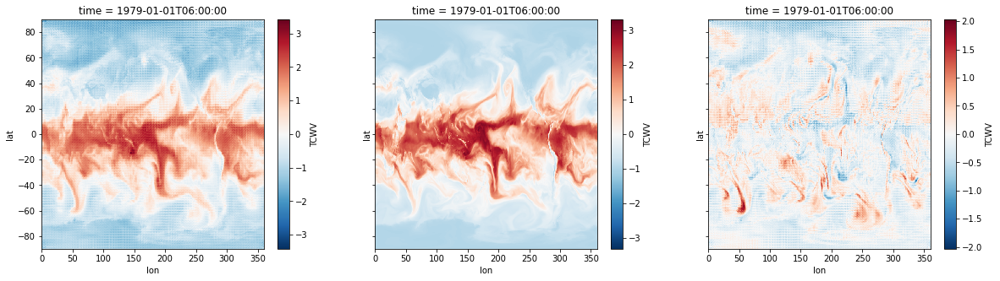

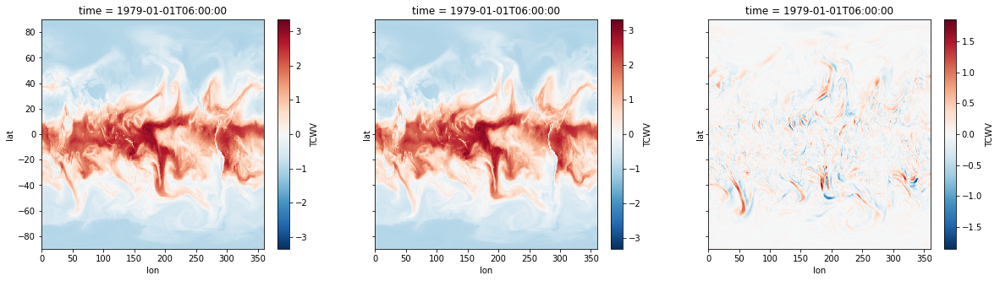

In [13]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(20, 5),
                         sharex=True, sharey=True)

# plot pred and target

plt.subplot(1, 3, 1)
outputs[0]['pred'][0]['TCWV'].plot()

plt.subplot(1, 3, 2)
outputs[0]['target'][0]['TCWV'].plot()

plt.subplot(1, 3, 3)
(outputs[0]['pred'][0]['TCWV'] - outputs[0]['target'][0]['TCWV']).plot()

plt.show()

# plot batch and target

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(20, 5),
                         sharex=True, sharey=True)

plt.subplot(1, 3, 1)
outputs[0]['batch'][0]['TCWV'].plot()

plt.subplot(1, 3, 2)
outputs[0]['target'][0]['TCWV'].plot()

plt.subplot(1, 3, 3)
(outputs[0]['batch'][0]['TCWV'] - outputs[0]['target'][0]['TCWV']).plot()

plt.show()

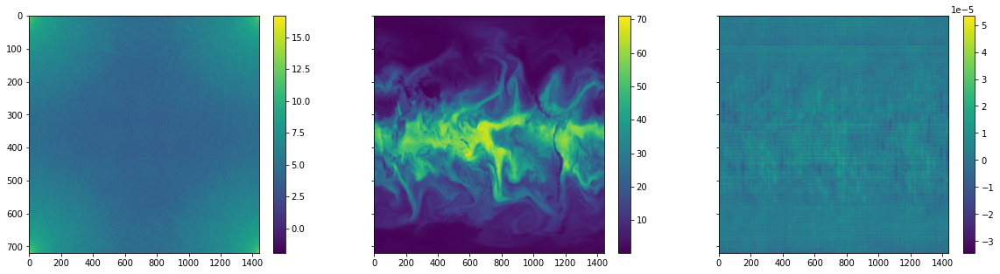

In [87]:
# plot tcwv in fourier space and reconstruction error

x = torch.tensor(outputs[0]['targets'][0]['TCWV'].data.squeeze(), device='cuda')
s = torch.fft.fft2(x)
x_hat = torch.fft.ifft2(s)

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(20, 5),
                         sharex=True, sharey=True)

plt.subplot(1, 3, 1)
plt.imshow(s.abs().log().cpu().numpy(), aspect='auto')
plt.colorbar()

plt.subplot(1, 3, 2)
plt.imshow(x_hat.abs().cpu().numpy(), aspect='auto')
plt.colorbar()

plt.subplot(1, 3, 3)
plt.imshow(x_hat.abs().cpu().numpy() - x.cpu().numpy(), aspect='auto')
plt.colorbar()

plt.show()

In [14]:
%%time

torch.cuda.empty_cache()

trainloader.unbatched().batched(1)

elapsed = 0.
pred_count = 0
outputs = []

for _, batch, bmeta, target, tmeta in trainloader:

    tic = time.perf_counter()

    # standardize batch
    means = batch.mean(dim=(2, 3), keepdim=True).expand(*batch.shape)
    stds = batch.std(dim=(2, 3), unbiased=True, keepdim=True).expand(*batch.shape)
    batch = batch.subtract_(means).div_(stds)
    
    s = torch.fft.rfft2(batch)
    s.requires_grad = True
    
    batch_recon = torch.fft.irfft2(s).abs()
    
    # batch = batch.to(device='cuda')
    # batch.requires_grad = True

    # prediction
    pred = model.forward(batch_recon.to('cuda'))
    elapsed += time.perf_counter() - tic
    
    del batch_recon
    
    # standardize target
    means = target.mean(dim=(2, 3), keepdim=True).expand(*target.shape)
    stds = target.std(dim=(2, 3), unbiased=True, keepdim=True).expand(*target.shape)
    target = target.subtract_(means).div_(stds).to(device='cuda')
    
    # get avg loss per variable
    losses = {
        tmeta[0][1][i]: F.mse_loss(pred[:, i:(i+1), :, :], target[:, i:(i+1), :, :])
        for i in range(pred.shape[1])
    }
    
    pred = pred.cpu().detach()
    target = target.cpu().detach()
    
    # calculate dl / ds
    # l: avg loss for one variable
    # s: fourier transform batch
    # attribution shapes are (batch size, # variables, lat size, lon size)
    # [ dl0 / ds, dl1 / ds, ...]
    attributions = {}
    for var, l in losses.items():
        grad = torch.autograd.grad(l, s, retain_graph=True)[0]
        attributions[var] = torch.fft.irfft2((s*grad).cpu().detach()).abs()
        del grad

    del s

    outputs.append({
        'target': preproc_to_dset(target, tmeta),
        'pred': preproc_to_dset(pred, tmeta),
        'error': preproc_to_dset(target - pred, tmeta),
        'attributions': {
            var: preproc_to_dset(attrib, bmeta)[0]
            for var, attrib in attributions.items()
        },
        'losses': { var: loss.cpu() for var, loss in losses.items() }
    })

    pred_count += pred.shape[0]

    print(f'\rsamples/s: {pred_count/elapsed:.3f}', end='')
    break

print()

torch.cuda.empty_cache()

samples/s: 0.693
CPU times: user 4min 9s, sys: 25.7 s, total: 4min 35s
Wall time: 9.33 s


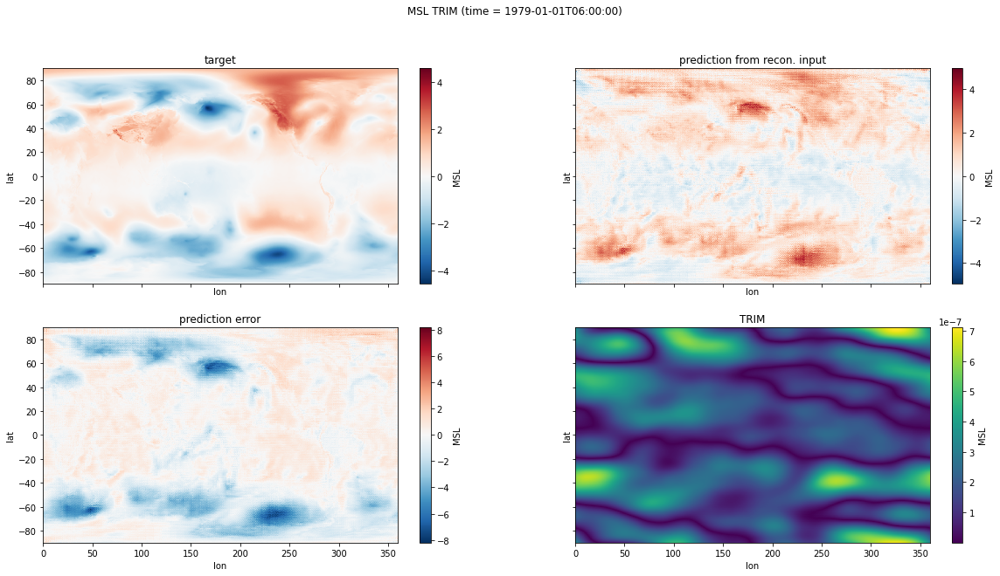

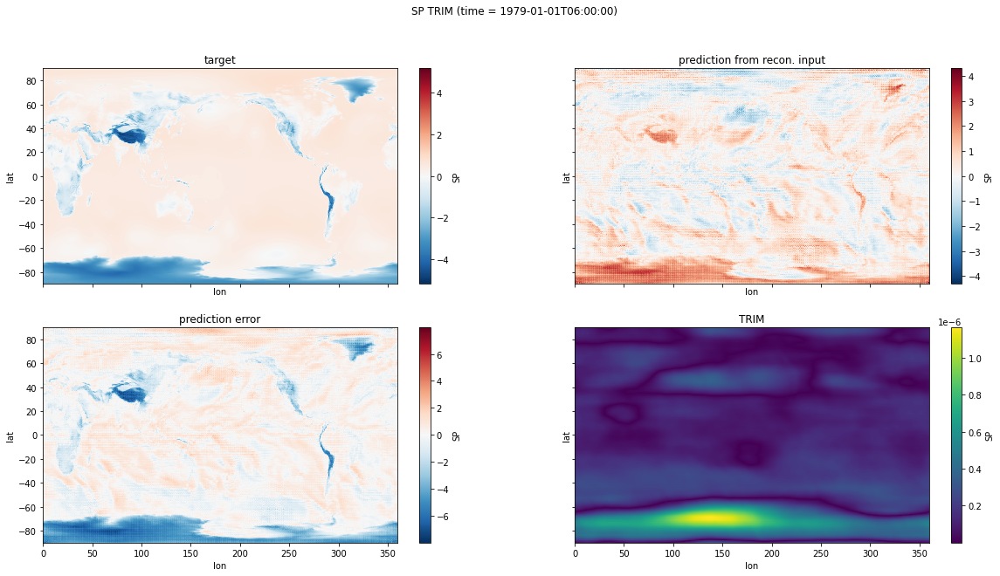

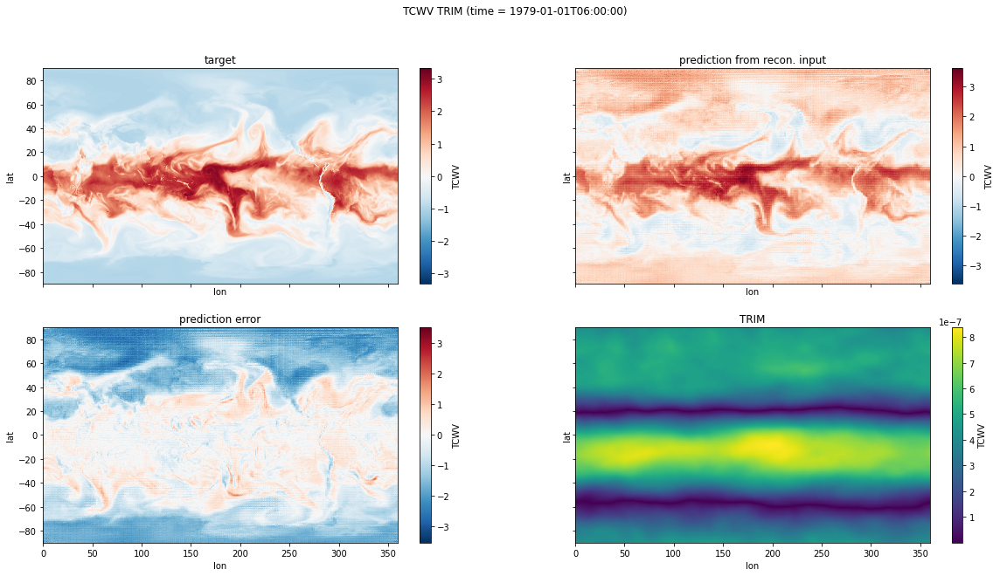

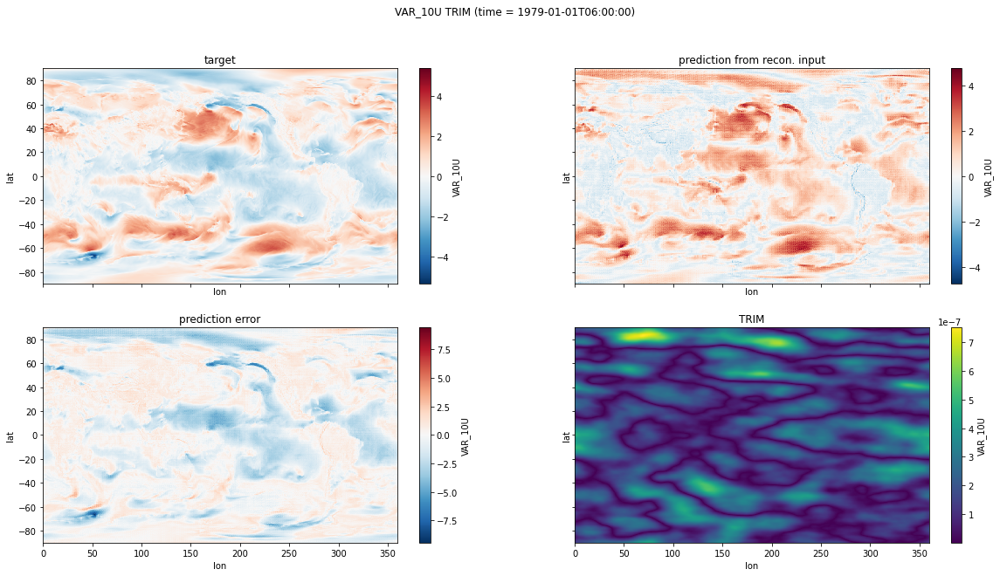

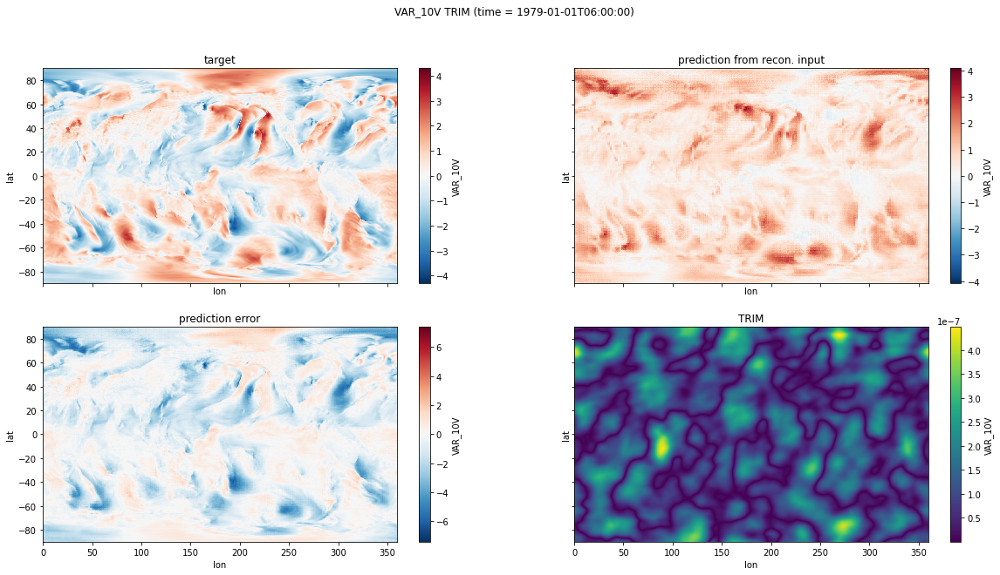

...

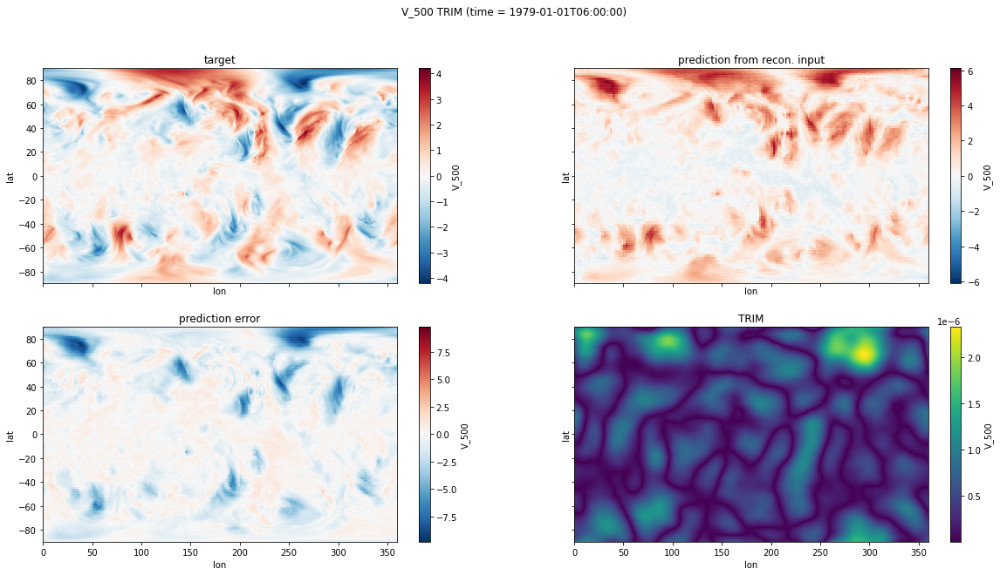

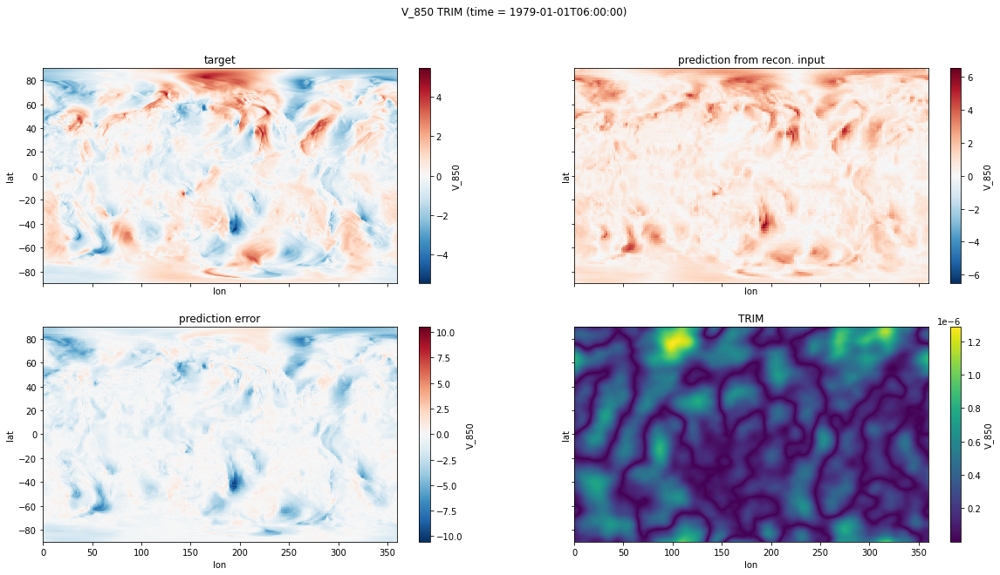

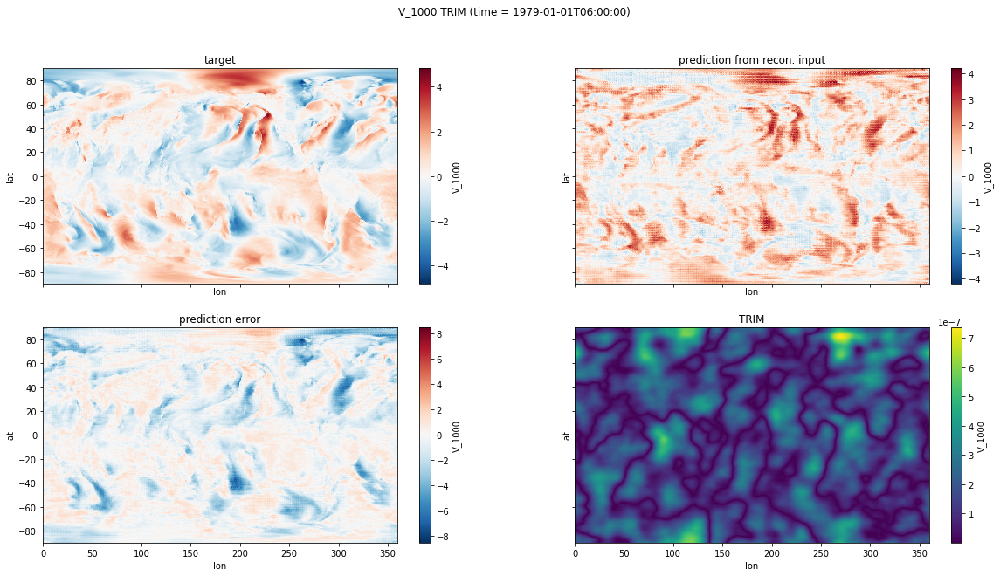

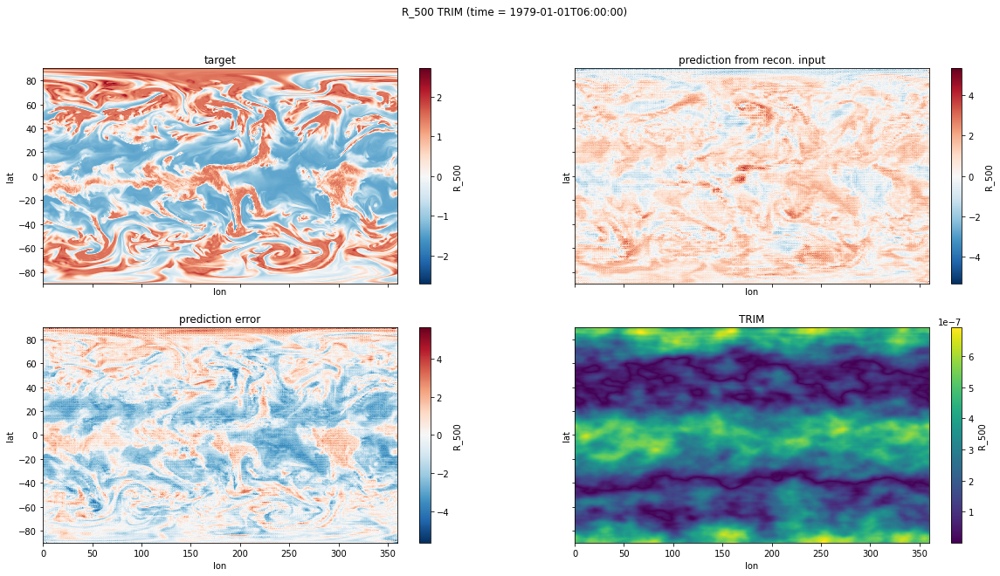

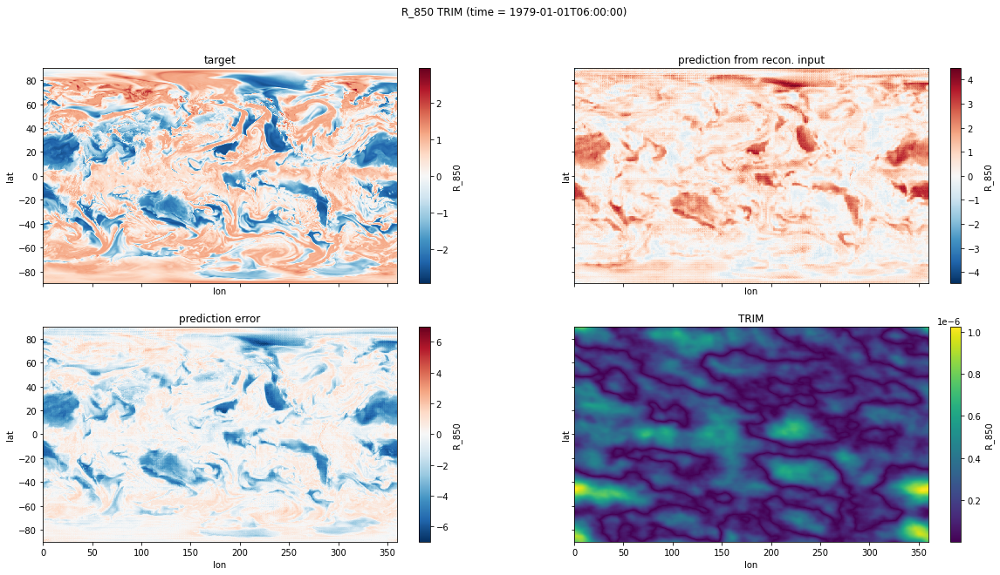

In [17]:
# plot input attributions (TRIM)

target = outputs[0]['target'][0]
pred = outputs[0]['pred'][0]
error = outputs[0]['error'][0]
attributions = outputs[0]['attributions']

for i, var in enumerate(pred.data_vars):

    fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20, 10),
                             sharex=True, sharey=True)

    plt.subplot(2, 2, 1)
    target[var].plot()
    
    fig.suptitle(f'{var} TRIM ({axes[0][0].title.get_text()})')
    axes[0][0].title.set_text('target')
    
    plt.subplot(2, 2, 2)
    pred[var].plot()
    axes[0][1].title.set_text('prediction from recon. input')
    
    plt.subplot(2, 2, 3)
    error[var].plot()
    axes[1][0].title.set_text('prediction error')

    plt.subplot(2, 2, 4)
    attributions[var][var].plot()
    axes[1][1].title.set_text('TRIM')

    plt.show()

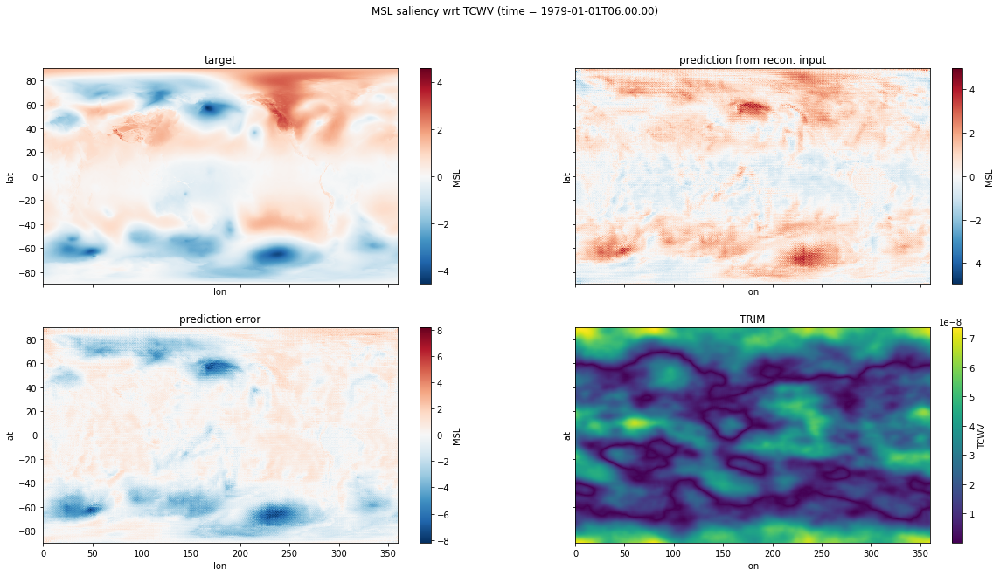

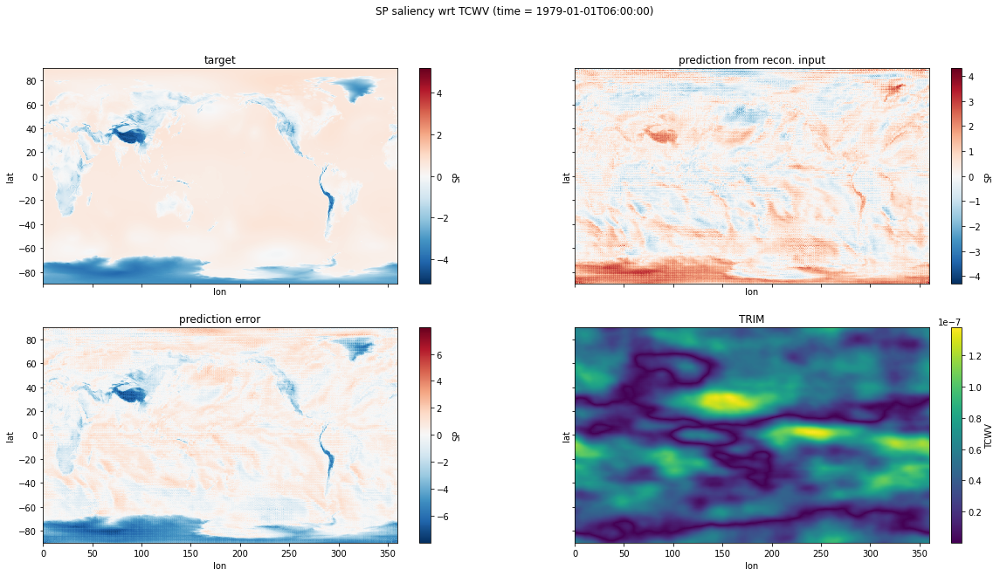

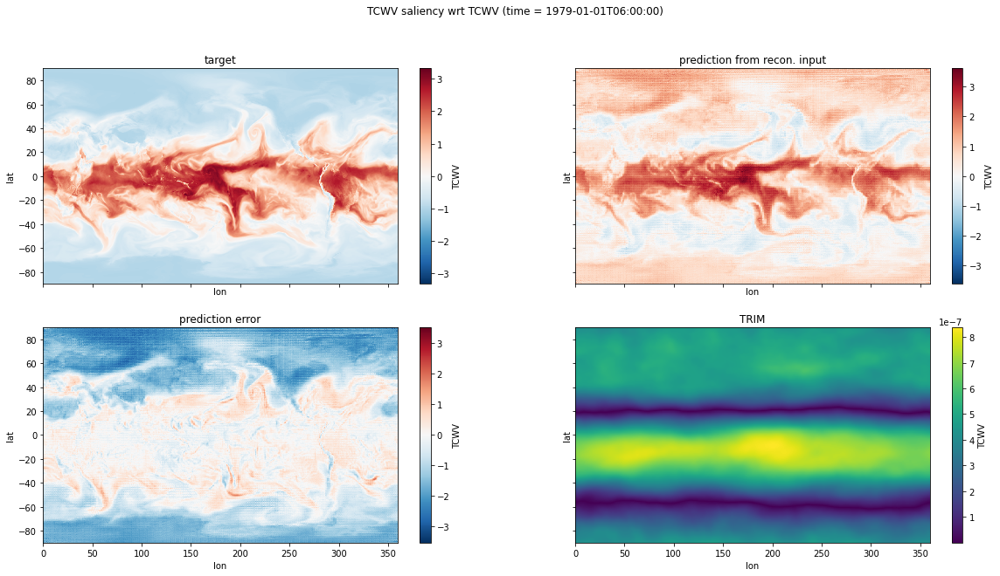

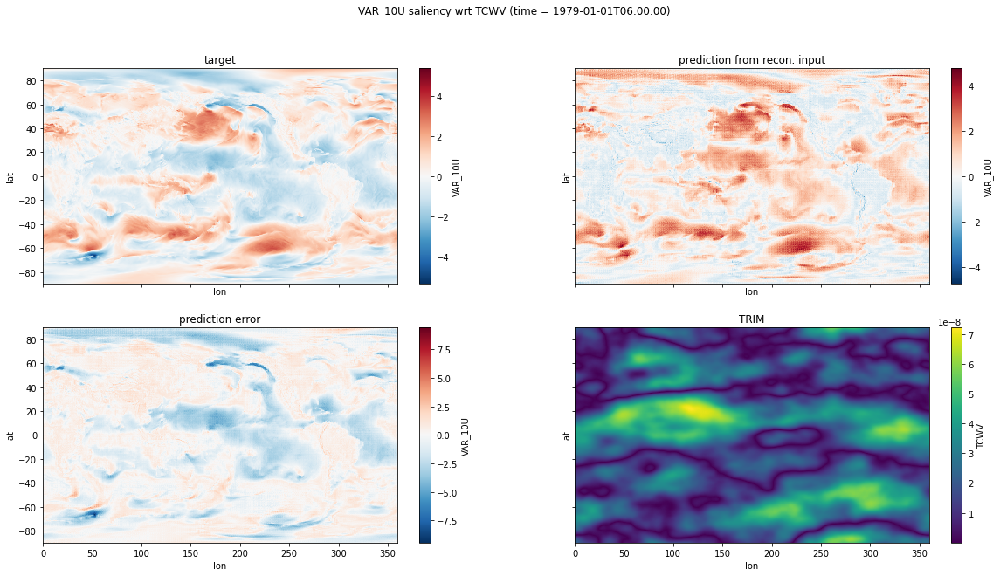

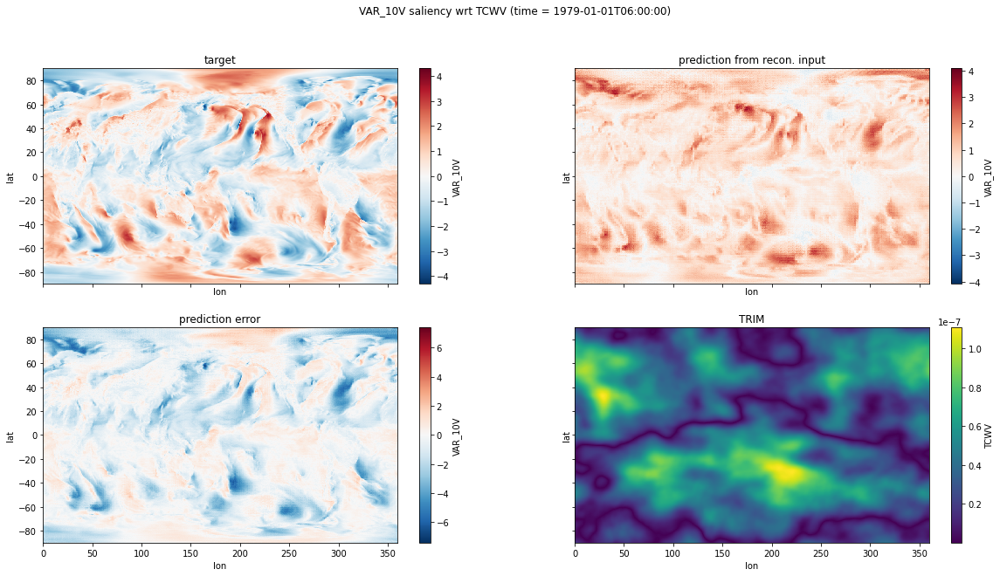

...

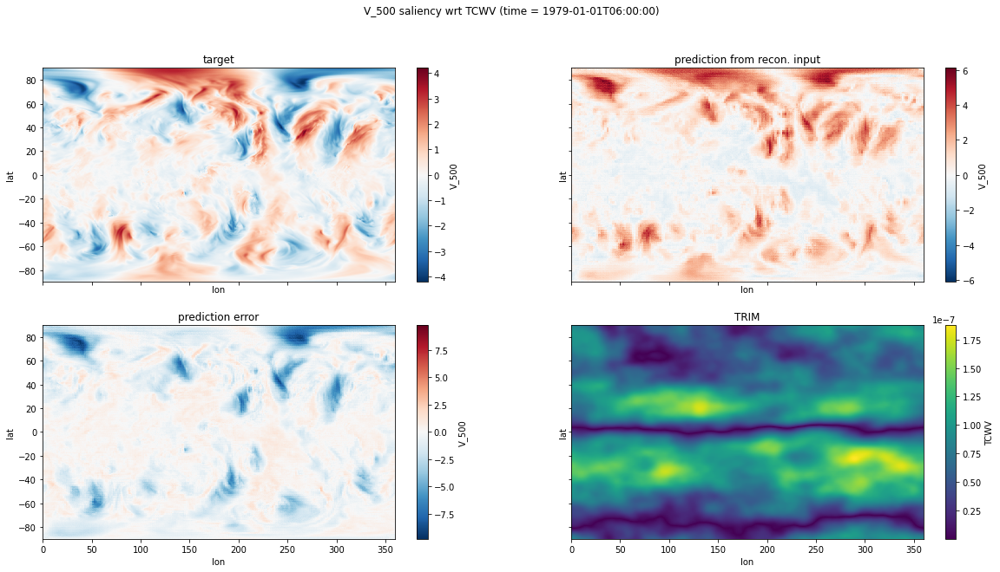

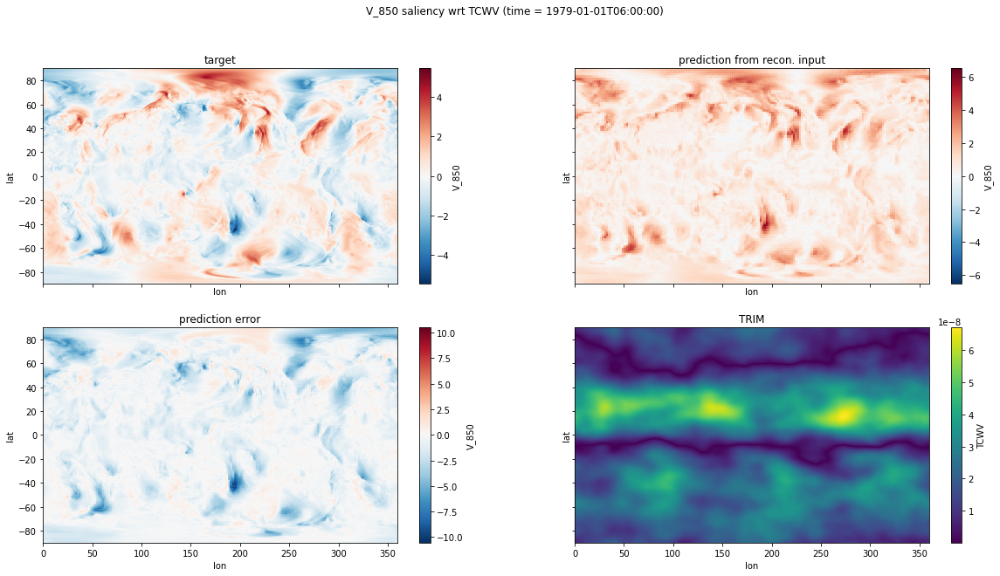

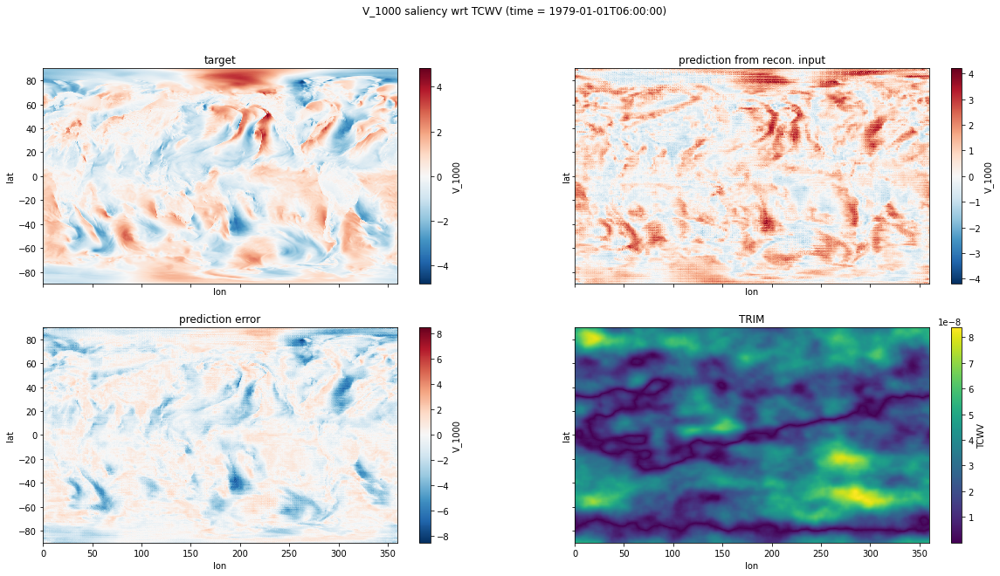

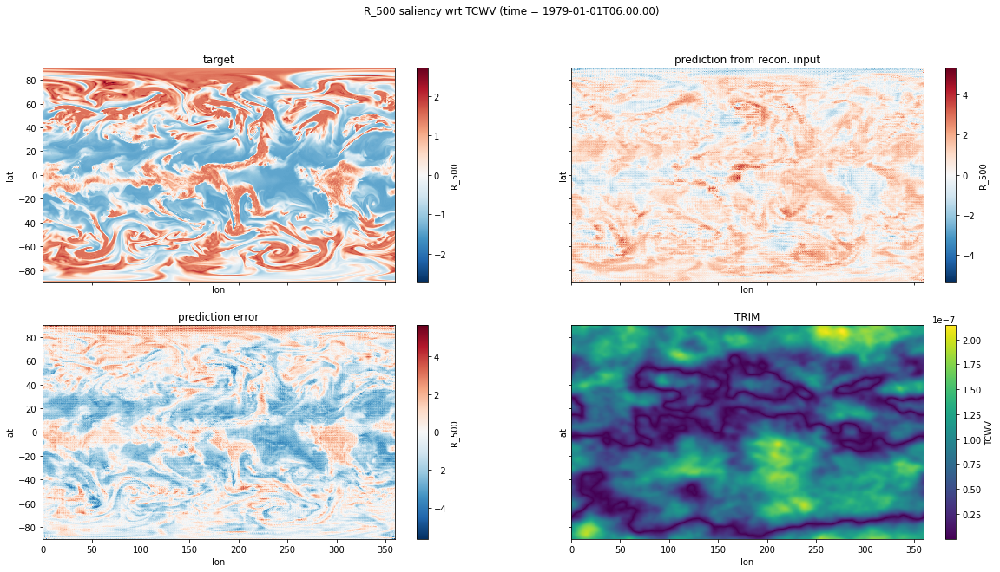

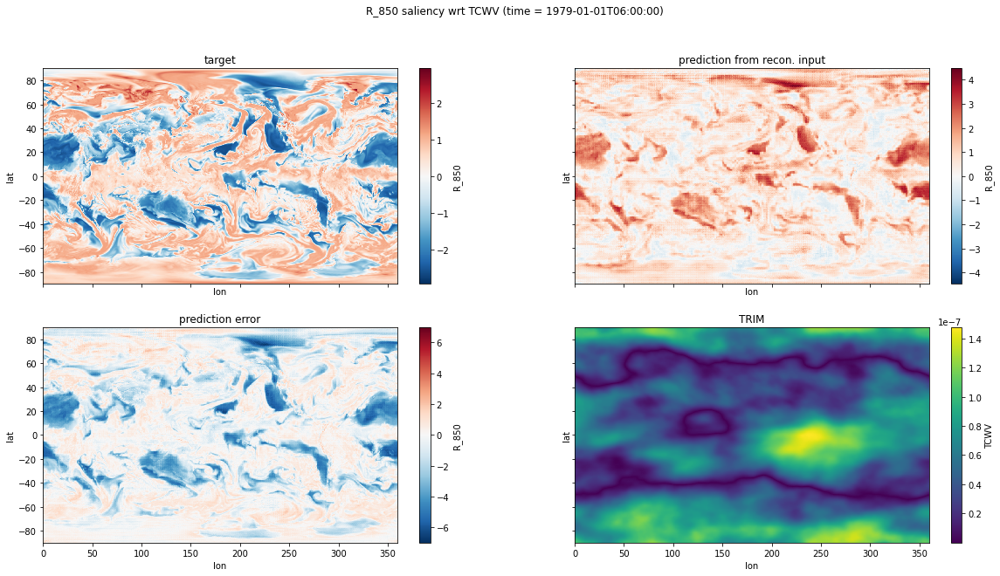

In [16]:
# plot input attributions (TRIM)

target = outputs[0]['target'][0]
pred = outputs[0]['pred'][0]
error = outputs[0]['error'][0]
attributions = outputs[0]['attributions']

for i, var in enumerate(pred.data_vars):

    fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20, 10),
                             sharex=True, sharey=True)

    plt.subplot(2, 2, 1)
    target[var].plot()
    
    fig.suptitle(f'{var} TRIM wrt TCWV ({axes[0][0].title.get_text()})')
    axes[0][0].title.set_text('target')
    
    plt.subplot(2, 2, 2)
    pred[var].plot()
    axes[0][1].title.set_text('prediction from recon. input')
    
    plt.subplot(2, 2, 3)
    error[var].plot()
    axes[1][0].title.set_text('prediction error')

    plt.subplot(2, 2, 4)
    attributions[var]['TCWV'].plot()
    axes[1][1].title.set_text('TRIM')

    plt.show()

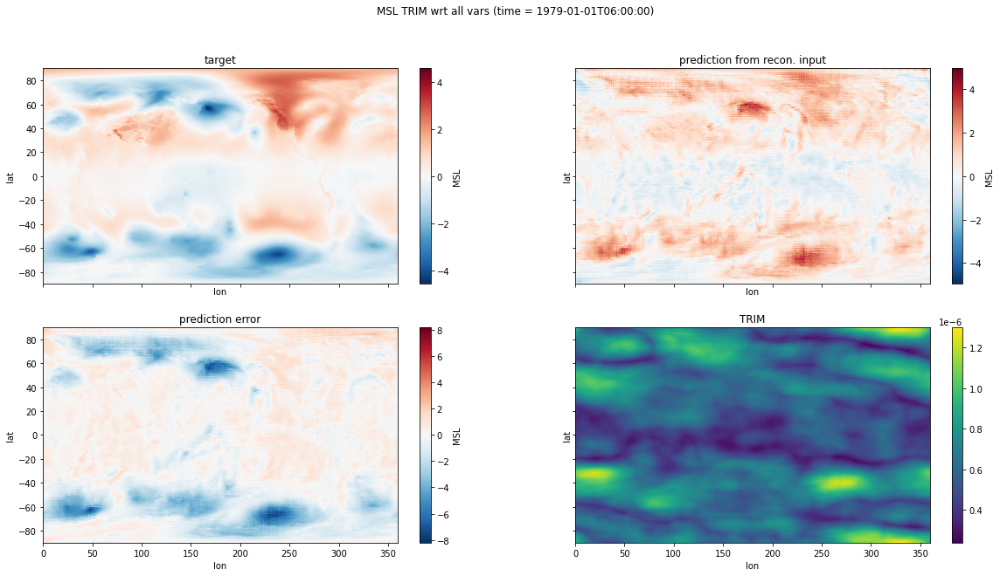

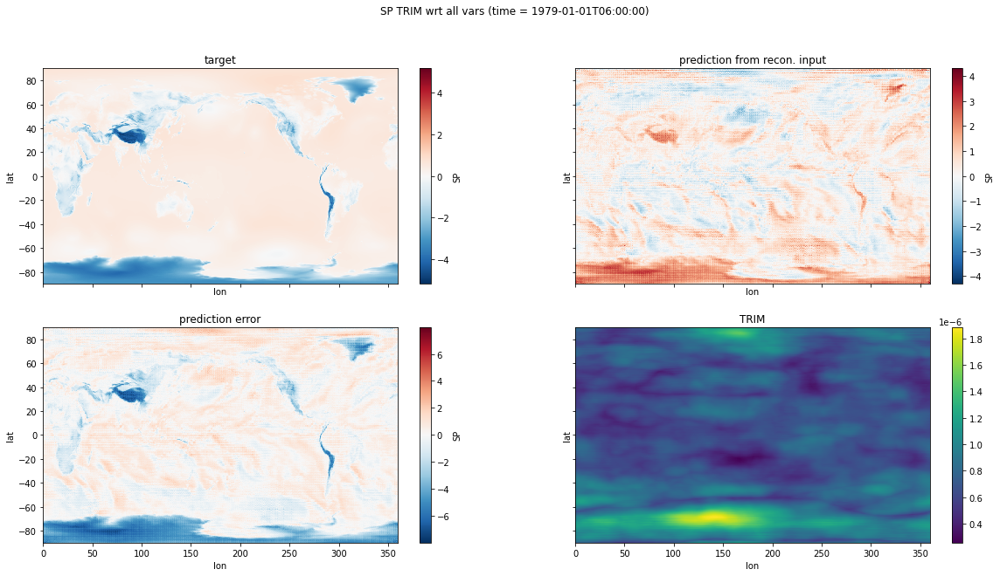

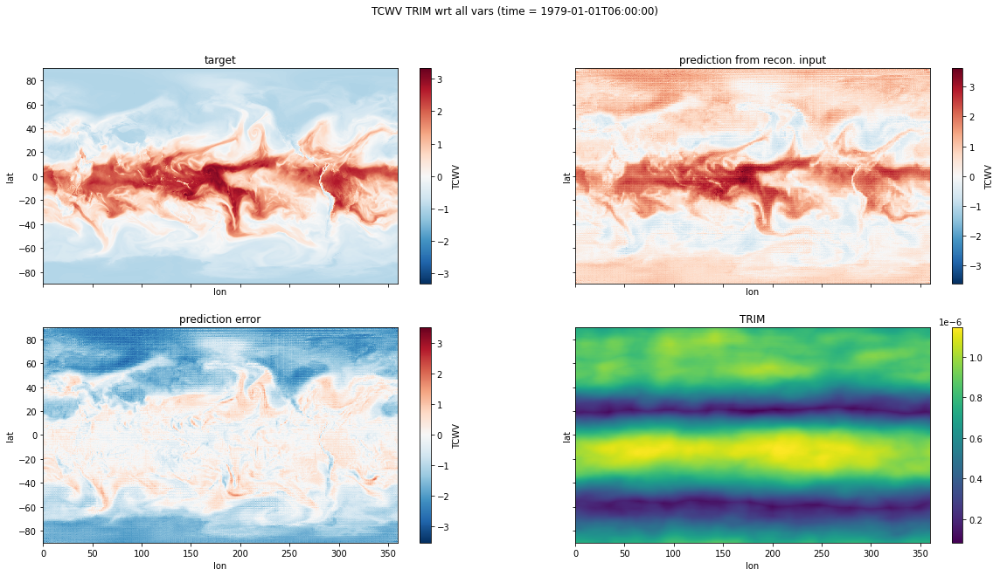

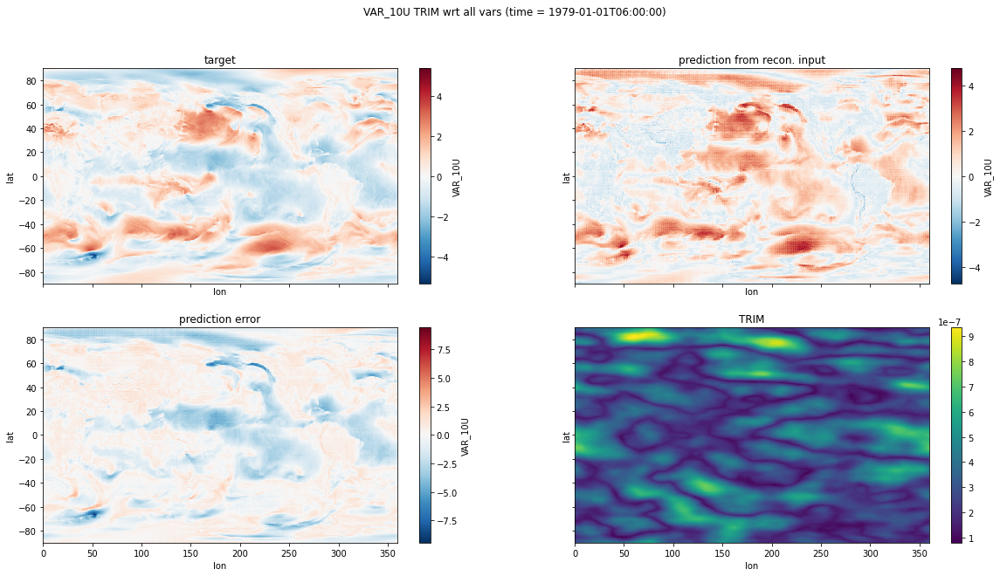

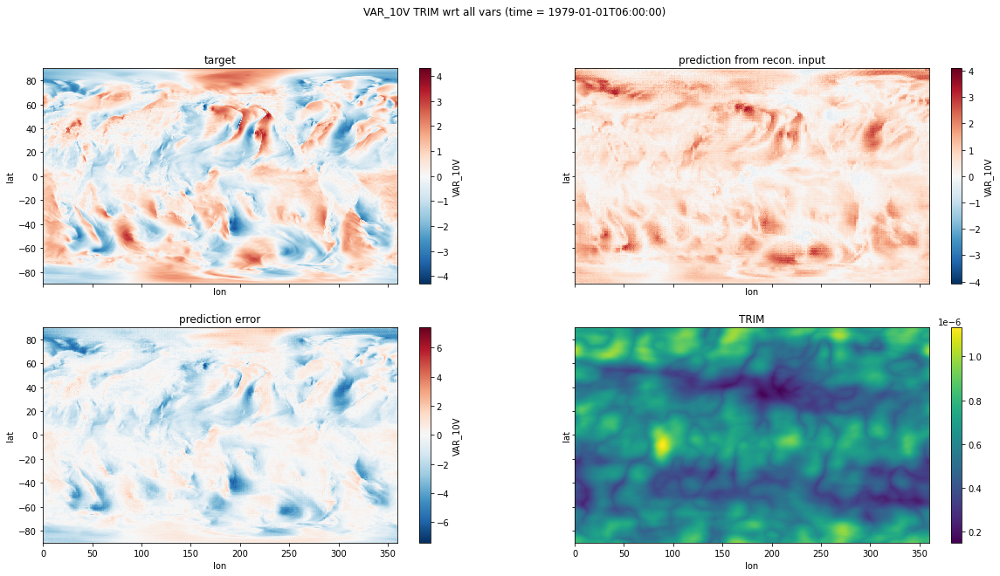

...

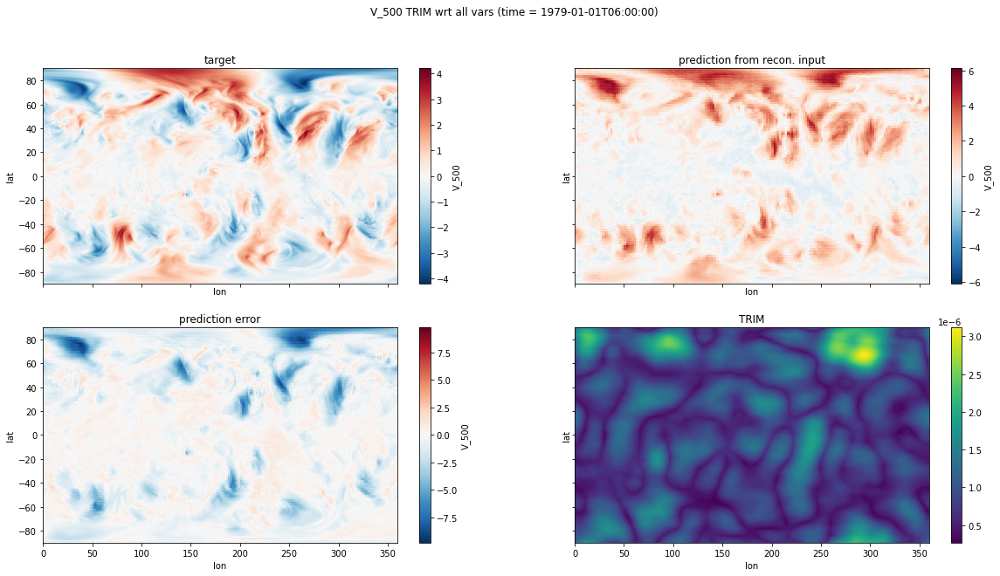

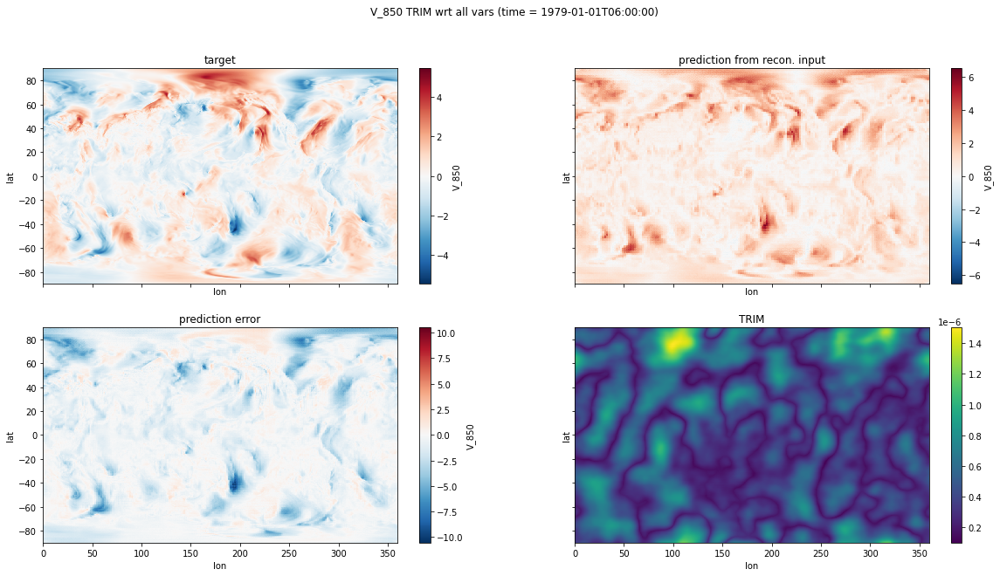

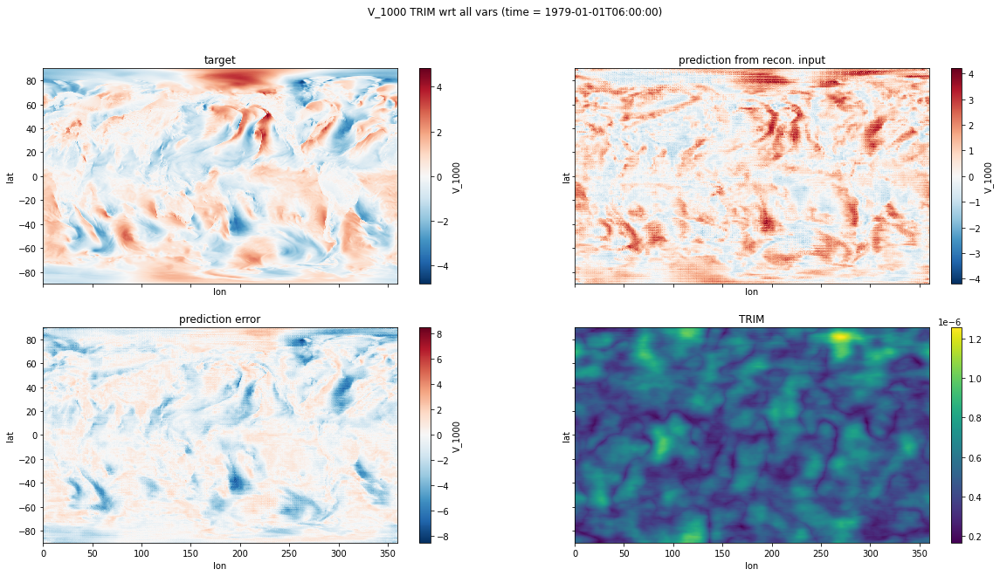

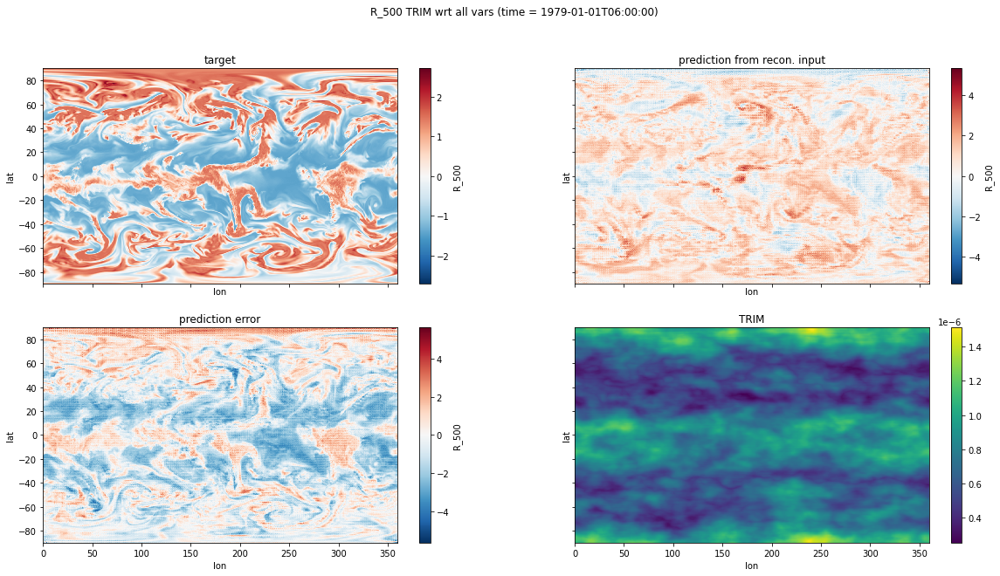

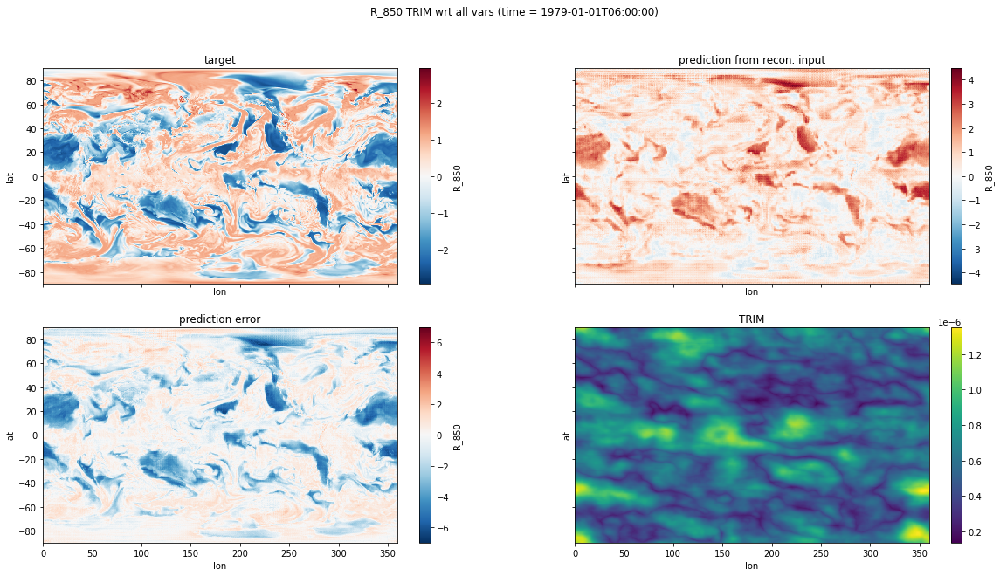

In [22]:
# plot input attributions (TRIM)

target = outputs[0]['target'][0]
pred = outputs[0]['pred'][0]
error = outputs[0]['error'][0]
attributions = outputs[0]['attributions']

for i, var in enumerate(pred.data_vars):

    fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20, 10),
                             sharex=True, sharey=True)

    plt.subplot(2, 2, 1)
    target[var].plot()
    
    fig.suptitle(f'{var} TRIM wrt all vars ({axes[0][0].title.get_text()})')
    axes[0][0].title.set_text('target')
    
    plt.subplot(2, 2, 2)
    pred[var].plot()
    axes[0][1].title.set_text('prediction from recon. input')
    
    plt.subplot(2, 2, 3)
    error[var].plot()
    axes[1][0].title.set_text('prediction error')

    plt.subplot(2, 2, 4)
    attributions[var].to_array().sum(dim='variable').plot()
    axes[1][1].title.set_text('TRIM')

    plt.show()